# Influence of intrument-specific embeddings on emotion recognition : The case of orchestral movie soundtrack from How To Train Your Dragon (HTTYD)

In the report attached to this notebook, we explored the quantitative influence of instrument-pretrained embeddings on emotion recognition for music and vice-versa using open-source datasets. However, we did not explore how the predictions of these models differed qualitatively from one pretraining and probing strategy to the other. This notebook studies and explores the predictions of pretrained models for emotion recognition and instrument tagging on two tracks of different genres but with high instrumental and emotional variety:

- Forbidden friendship from the film How To Train Your Dragon, an orchestral track with a wide range of emotions (See Section )
- X

Through this, we aim to examine the predictions of in-domain models as well as out-of-domain trained models and take note of the differences in predictions between these models for these two tracks from relatively different styles and genres.

## 1. Imports, definitions
### 1.1 : Importing libraries

In [1]:
# necessary imports
import torchaudio
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import seaborn as sns
import soundfile as sf


### 1.2 importing local models and defining one model per downstream task

In [2]:
from SemiSupCon.models.finetuning import FinetuneSemiSupCon
from SemiSupCon.models.encoders.samplecnn import SampleCNN

moodtheme_model = FinetuneSemiSupCon(encoder=SampleCNN(), task='mtg_mood')
instrument_model = FinetuneSemiSupCon(encoder=SampleCNN(), task='mtg_instr')
emomusic_model = FinetuneSemiSupCon(encoder=SampleCNN(), task='emomusic',mlp_head=False)
medleydb_instrument_model = FinetuneSemiSupCon(encoder=SampleCNN(), task='medleydb')

# get available devices and send all models
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

moodtheme_model.to(device)
instrument_model.to(device)
emomusic_model.to(device)
medleydb_instrument_model.to(device)

# freeze and eval all
moodtheme_model.freeze()
instrument_model.freeze()
emomusic_model.freeze()
medleydb_instrument_model.freeze()


/homes/jpmg86/anaconda3/envs/MuMRVQ/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Encoder is frozen
Encoder is frozen
Encoder is frozen
Encoder is frozen


### 1.3 Defining checkpoints for each pretraining dataset and each downstream probing dataset

We choose to restrain ourselves to 3 pretraining tasks: MedleyDB, MTG Jamendo Mood/theme and MTG Jamendo Instrumentation. To these for downstream probing we add emomusic. We choose to discard medleyDB and Nsynth-Instrument due to their single-label capabilities, which are less prone to interpretation in visualization than the multilabel tagging approach. This decision is also influenced by a desire to not bloat this notebook with thousands of visualizations.

In [3]:
# defining checkpoint paths of format pretraining_task : {evaluation_task : checkpoint_path}

checkpoints = {
    'moodtheme' : {
        'moodtheme' : 'Checkpoints-finetuning/filigreed-rooster-83_finetune_ablaze-carnation-74_mtg_mood/best-val-step=1705.ckpt',
        'instrument' : 'Checkpoints-finetuning/glittering-rooster-85_finetune_ablaze-carnation-74_mtg_instr/best-val-step=1344.ckpt',
        'emomusic' : 'Checkpoints-finetuning/vibrant-ox-121_finetune_ablaze-carnation-74_emomusic/best-val-step=266.ckpt',
    },
    'instrument' : {
        'moodtheme' : 'Checkpoints-finetuning/deeply-chocolate-72_finetune_euphoric-violet-75_mtg_mood/best-val-step=1705.ckpt',
        'instrument' : 'Checkpoints-finetuning/yearning-tulip-74_finetune_euphoric-violet-75_mtg_instr/best-val-step=1344.ckpt',
        'emomusic' : 'Checkpoints-finetuning/fortuitous-pig-122_finetune_euphoric-violet-75_emomusic/best-val-step=91.ckpt',
    },
    'medleydb' : {
        'moodtheme' : 'Checkpoints-finetuning/eternal-paper-268_finetune_legendary-laughter-106_mtg_mood/best-val-step=1705.ckpt',
        'instrument' : 'Checkpoints-finetuning/warm-wood-269_finetune_legendary-laughter-106_mtg_instr/best-val-step=2464.ckpt',
        'emomusic' : 'Checkpoints-finetuning/glowing-rabbit-243_finetune_legendary-laughter-106_emomusic/best-val-step=406.ckpt',
    }
}

### Defining classes for each task for later visualization

Because number of classes as well as index-class correspondence are determined at dataloading time and all data is currently on the C4DM servers, we manually create the dictionaries for each model here.

In [4]:
moodtheme_classes = {0: 'mood/theme---background',
 1: 'mood/theme---film',
 2: 'mood/theme---melancholic',
 3: 'mood/theme---melodic',
 4: 'mood/theme---children',
 5: 'mood/theme---relaxing',
 6: 'mood/theme---documentary',
 7: 'mood/theme---emotional',
 8: 'mood/theme---space',
 9: 'mood/theme---love',
 10: 'mood/theme---drama',
 11: 'mood/theme---adventure',
 12: 'mood/theme---energetic',
 13: 'mood/theme---heavy',
 14: 'mood/theme---dark',
 15: 'mood/theme---calm',
 16: 'mood/theme---action',
 17: 'mood/theme---dramatic',
 18: 'mood/theme---epic',
 19: 'mood/theme---powerful',
 20: 'mood/theme---upbeat',
 21: 'mood/theme---slow',
 22: 'mood/theme---inspiring',
 23: 'mood/theme---soft',
 24: 'mood/theme---meditative',
 25: 'mood/theme---fun',
 26: 'mood/theme---happy',
 27: 'mood/theme---positive',
 28: 'mood/theme---romantic',
 29: 'mood/theme---sad',
 30: 'mood/theme---hopeful',
 31: 'mood/theme---motivational',
 32: 'mood/theme---deep',
 33: 'mood/theme---uplifting',
 34: 'mood/theme---ballad',
 35: 'mood/theme---soundscape',
 36: 'mood/theme---dream',
 37: 'mood/theme---movie',
 38: 'mood/theme---fast',
 39: 'mood/theme---nature',
 40: 'mood/theme---cool',
 41: 'mood/theme---corporate',
 42: 'mood/theme---travel',
 43: 'mood/theme---funny',
 44: 'mood/theme---sport',
 45: 'mood/theme---commercial',
 46: 'mood/theme---advertising',
 47: 'mood/theme---holiday',
 48: 'mood/theme---christmas',
 49: 'mood/theme---sexy',
 50: 'mood/theme---game',
 51: 'mood/theme---groovy',
 52: 'mood/theme---retro',
 53: 'mood/theme---summer',
 54: 'mood/theme---party',
 55: 'mood/theme---trailer'}
moodtheme_model.set_idx2class(moodtheme_classes)

instrument_classes = {0: 'instrument---voice',
 1: 'instrument---synthesizer',
 2: 'instrument---piano',
 3: 'instrument---strings',
 4: 'instrument---beat',
 5: 'instrument---guitar',
 6: 'instrument---cello',
 7: 'instrument---keyboard',
 8: 'instrument---trombone',
 9: 'instrument---clarinet',
 10: 'instrument---doublebass',
 11: 'instrument---horn',
 12: 'instrument---trumpet',
 13: 'instrument---violin',
 14: 'instrument---accordion',
 15: 'instrument---bass',
 16: 'instrument---computer',
 17: 'instrument---drummachine',
 18: 'instrument---drums',
 19: 'instrument---electricguitar',
 20: 'instrument---sampler',
 21: 'instrument---acousticguitar',
 22: 'instrument---harmonica',
 23: 'instrument---flute',
 24: 'instrument---pipeorgan',
 25: 'instrument---harp',
 26: 'instrument---electricpiano',
 27: 'instrument---oboe',
 28: 'instrument---saxophone',
 29: 'instrument---percussion',
 30: 'instrument---acousticbassguitar',
 31: 'instrument---orchestra',
 32: 'instrument---bongo',
 33: 'instrument---brass',
 34: 'instrument---viola',
 35: 'instrument---rhodes',
 36: 'instrument---organ',
 37: 'instrument---classicalguitar',
 38: 'instrument---bell',
 39: 'instrument---pad'}
instrument_model.set_idx2class(instrument_classes)

medleydb_classes = {0: 'bassoon',
 1: 'piano',
 2: 'acoustic guitar',
 3: 'double bass',
 4: 'synthesizer',
 5: 'clean electric guitar',
 6: 'flute',
 7: 'violin',
 8: 'drum set',
 9: 'male singer',
 10: 'vocalists',
 11: 'distorted electric guitar',
 12: 'female singer',
 13: 'electric bass',
 14: 'tenor saxophone',
 15: 'clarinet',
 16: 'fx/processed sound',
 17: 'violin section',
 18: 'cello',
 19: 'drum machine'}
medleydb_instrument_model.set_idx2class(medleydb_classes)

emomusic_classes = {
    0 : "arousal",
    1 : "valence"
}
emomusic_model.set_idx2class(emomusic_classes)

### Loading utilities and activation extraction utilities.

Because we know which activation corresponds to each task, we can define them here. In a productionized setting this would of course have to be ported to config.

In [5]:
DEFAULT_SR = 22050
DEFAULT_TARGET_LENGTH = 2.7
DEFAULT_TARGET_SAMPLES = DEFAULT_SR * DEFAULT_TARGET_LENGTH
DEFAULT_OVERLAP = 0
DEFAULT_SAMPLES_PER_CHUNK = (1-DEFAULT_OVERLAP) * DEFAULT_TARGET_SAMPLES
DEFAULT_SECONDS_PER_CHUNK = DEFAULT_SAMPLES_PER_CHUNK / DEFAULT_SR

from tqdm import tqdm


def load_full_audio(path, target_sr):
    audio, sr = sf.read(path, always_2d=True, dtype='float32')
    audio = torch.tensor(audio.T)
    # resample to target sample rate
    audio = torchaudio.functional.resample(audio, sr, target_sr)
    return audio

def load_full_and_split(path, target_sr = DEFAULT_SR, target_n_samples  = DEFAULT_TARGET_SAMPLES, overlap = DEFAULT_OVERLAP):
    audio = load_full_audio(path, target_sr)
    audio = audio.mean(0)
    audio = audio.unfold(-1, int(target_n_samples), int(target_n_samples) - int(target_n_samples*overlap)).unsqueeze(1).unsqueeze(1)
    return audio

def get_activations_from_model(model,path,checkpoint_path, overlap = DEFAULT_OVERLAP):
    model.load_checkpoint(checkpoint_path)
    audio_input = load_full_and_split(path, overlap = overlap)
    
    # split into batch sizes of 32 to prevent oom
    batch_size = 32
    n_chunks = audio_input.size(0)
    activations = []
    with torch.no_grad():
        for i in tqdm(range(0, n_chunks, batch_size)):
            chunk = audio_input[i:i+batch_size]
            output = model(chunk)
            logits = output['projected']
            if model.task == 'mtg_mood' or model.task == 'mtg_instr':
                activations.append(torch.sigmoid(logits))
            elif model.task == 'medleydb':
                activations.append(torch.softmax(logits, dim=-1))
            else:
                activations.append(logits)

    activations = torch.cat(activations, dim=0)
        
    return activations, model.idx2class

### 1.5 Plotting utilities

For visualization we define a few helper methods:

- Standard visualization of waveform and spectrogram
- Taggram plotting, which plots the activation for each class for multiclass and multilabel models
- Arousal/Valence plotting, which plots a lineplot of arousal and valence through time

In [6]:

# plot spectrogram and waveform using librosa
import librosa.display
import numpy as np

def plot_spectrogram_and_waveform(audio, sr, axs=None):
    # fqirly low resolution spectrogram
    D = librosa.amplitude_to_db(np.abs(librosa.stft(audio[0].numpy())), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log', ax=axs[0])
    plt.title('Spectrogram')
    
    # share x axis
    axs[1].plot(np.linspace(0, len(audio[0])/sr, len(audio[0])), audio[0], color = 'black')
    # grid on axs[1]
    axs[1].grid()
    plt.title('Waveform')
    
    plt.tight_layout()

def plot_taggram(activations, idx2class, title, ax  = None, topk = 10, overlap = DEFAULT_OVERLAP):
    
    # sort to top 10 classes per max activation and keep only those
    
    seconds_per_chunk = (1 - overlap) * DEFAULT_TARGET_LENGTH
    
    classes = list(idx2class.values())
    activations = activations.numpy()
    # get max activation over the whole time axis
    max_activations = activations.mean(0)
    # get top 10 classes per max activation
    top_classes = np.argsort(max_activations)[-topk:]
    # keep only those classes
    activations = activations[:, top_classes]
    classes = [classes[i] for i in top_classes]
    
    # apply a rolling smoothing filter to the activations while keeping the same shape
    activations = np.apply_along_axis(lambda x: np.convolve(x, np.ones(2)/2, mode='same'), axis=0, arr=activations)
    

    
    
    sns.heatmap(activations.T, ax=ax, cmap='Reds', xticklabels=False, yticklabels=classes)
    ax.set_title(title)
    # set the x axis to time and use default seconds per chunk to set appropriate values every 20 seconds
    
    ax.set_xlabel('Time (s)')
    ax.set_xticks([i for i in range(0, activations.shape[0], int(20/seconds_per_chunk))])
    # format time to min:sec
    ax.set_xticklabels([f'{int(i*seconds_per_chunk//60)}:{int(i*seconds_per_chunk%60):02d}' for i in range(0, activations.shape[0], int(20/seconds_per_chunk))])
    
    
def plot_AV_activations(activations, idx2class, title, ax = None, overlap = DEFAULT_OVERLAP, **kwargs):
    """plot a lineplot of arousal (red) and valence (blue) activations"""
    
    arousal = activations[:,0].numpy()
    valence = activations[:,1].numpy()
    
    # smooth
    arousal = np.convolve(arousal, np.ones(3)/3, mode='same')
    valence = np.convolve(valence, np.ones(3)/3, mode='same')
    
    ax.plot(arousal, color='red', label='arousal', **kwargs)
    ax.plot(valence, color='blue', label='valence', **kwargs)
    
    ax.set_title(title)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Arousal/Valence')
    
    seconds_per_chunk = (1 - overlap) * DEFAULT_TARGET_LENGTH
    ax.set_xticks([i for i in range(0, activations.shape[0], int(20/seconds_per_chunk))])
    # format time to min:sec
    ax.set_xticklabels([f'{int(i*seconds_per_chunk//60)}:{int(i*seconds_per_chunk%60):02d}' for i in range(0, activations.shape[0], int(20/seconds_per_chunk))])
    #xlim 
    ax.set_xlim(0, activations.shape[0])
    # set appropriate legend
    ax.legend()

## 2. Case study 1 : Test Drive - How to train your dragon

In this brief section we showcase a few plots for the track for in-domain models. i.e., we extract the activations for all models pretrained and probed on the same task as a sanity check for their performance as well as a baseline to compare further results to.

This track from the animated film how to train yor dragon is instrumentally complex but emotionally rather constant, apart from a few key moments that we will be looking to see if our models are capable of capturing.

### 2.1 Track loading and activation extraction examples


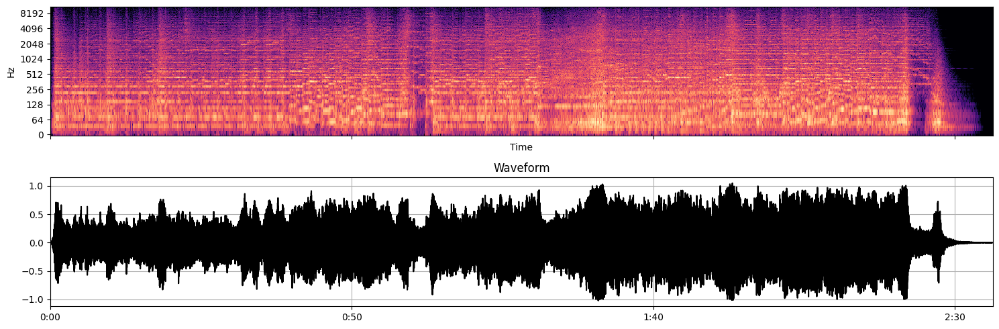

In [7]:
# example loading and predicting
from IPython.display import Audio
import numpy as np
DEFAULT_AUDIO_PATH = 'case_study_audio/test_drive_httyd.wav'

audio = load_full_audio(DEFAULT_AUDIO_PATH, DEFAULT_SR)
Audio(audio[0].numpy(), rate=DEFAULT_SR)


    
fig, axs = plt.subplots(2, 1, figsize=(15, 5), sharex=True)
plot_spectrogram_and_waveform(audio, DEFAULT_SR, axs)

Audio(audio[0].numpy(), rate=DEFAULT_SR)


  0%|          | 0/18 [00:00<?, ?it/s]/homes/jpmg86/anaconda3/envs/MuMRVQ/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
 22%|██▏       | 4/18 [00:01<00:05,  2.39it/s]

100%|██████████| 18/18 [00:07<00:00,  2.52it/s]


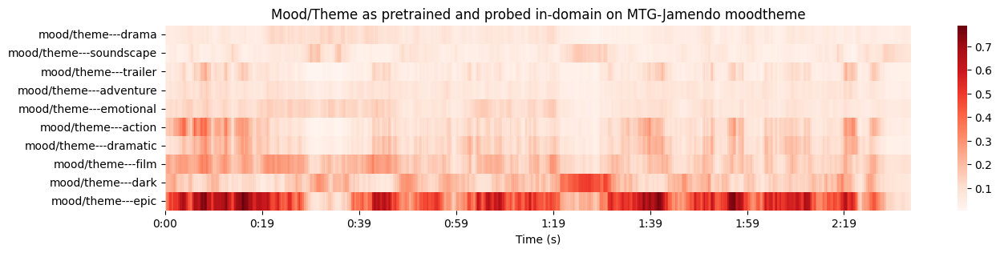

In [8]:

    
moodtheme_activations, moodtheme_classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['moodtheme'], overlap = 0.9)
fig,ax = plt.subplots(figsize=(15, 3))
plot_taggram(moodtheme_activations, moodtheme_classes, 'Mood/Theme as pretrained and probed in-domain on MTG-Jamendo moodtheme', ax = ax, overlap = 0.9)

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:07<00:00,  2.51it/s]


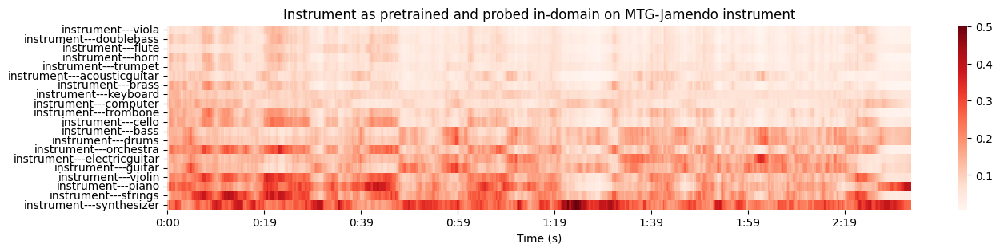

In [9]:
instrument_activations, instrument_classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['instrument'], overlap = 0.9)
fig,ax = plt.subplots(figsize=(15, 3))
plot_taggram(instrument_activations, instrument_classes, 'Instrument as pretrained and probed in-domain on MTG-Jamendo instrument', ax = ax, topk = 20, overlap=0.9)

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:07<00:00,  2.54it/s]


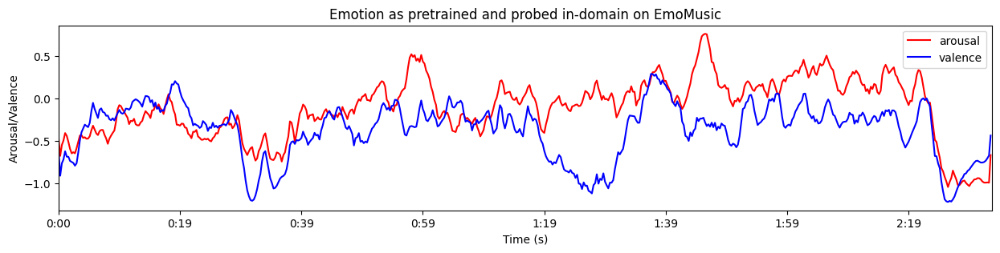

In [10]:
emomusic_activations, emomusic_classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['emomusic'], overlap=0.9)
fig,ax = plt.subplots(figsize=(15, 3))
plot_AV_activations(emomusic_activations, emomusic_classes, 'Emotion as pretrained and probed in-domain on EmoMusic', ax = ax, overlap = 0.9)

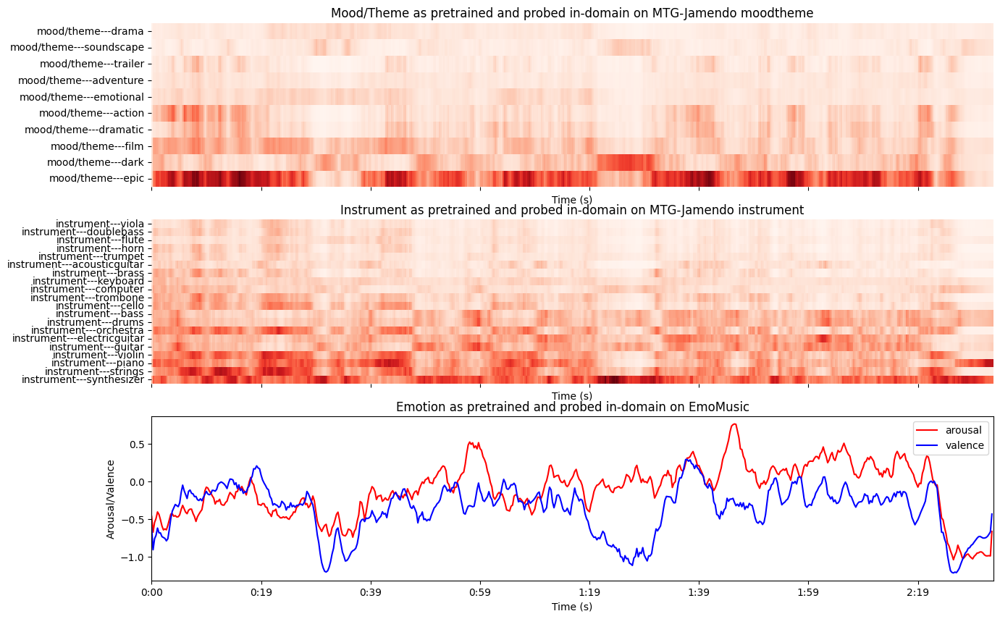

In [11]:
## all three on same subfigs
fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_taggram(moodtheme_activations, moodtheme_classes, 'Mood/Theme as pretrained and probed in-domain on MTG-Jamendo moodtheme', ax = axs[0], overlap = 0.9)
plot_taggram(instrument_activations, instrument_classes, 'Instrument as pretrained and probed in-domain on MTG-Jamendo instrument', ax = axs[1], topk = 20, overlap=0.9)
plot_AV_activations(emomusic_activations, emomusic_classes, 'Emotion as pretrained and probed in-domain on EmoMusic', ax = axs[2], overlap = 0.9)

# remove cbar from moodtheme and instrument
axs[0].collections[0].colorbar.remove()
axs[1].collections[0].colorbar.remove()

These activations all follow the track very accurately. Not only are changed in the mood portrayed through changes in mood tagging, but also through valence/arousal evolution, where lower valence denotes darker, more somber tones. At the small, calmer ostinato at the start we see a decrease in arousal, and heights in the music's energy are well captured by the arousal curve. This is a generally energetic track so there is no surprise as to the high arousal values throughout.

### 2.2. Comparison between different pretraining datasets for this track

We now turn to comparing the different activations and predictions for one same downstream task across pretraining strategies. To do so, we plot all three pretrained model activations for all downstream tasks.  The following Figures show these visualizations.

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:07<00:00,  2.57it/s]


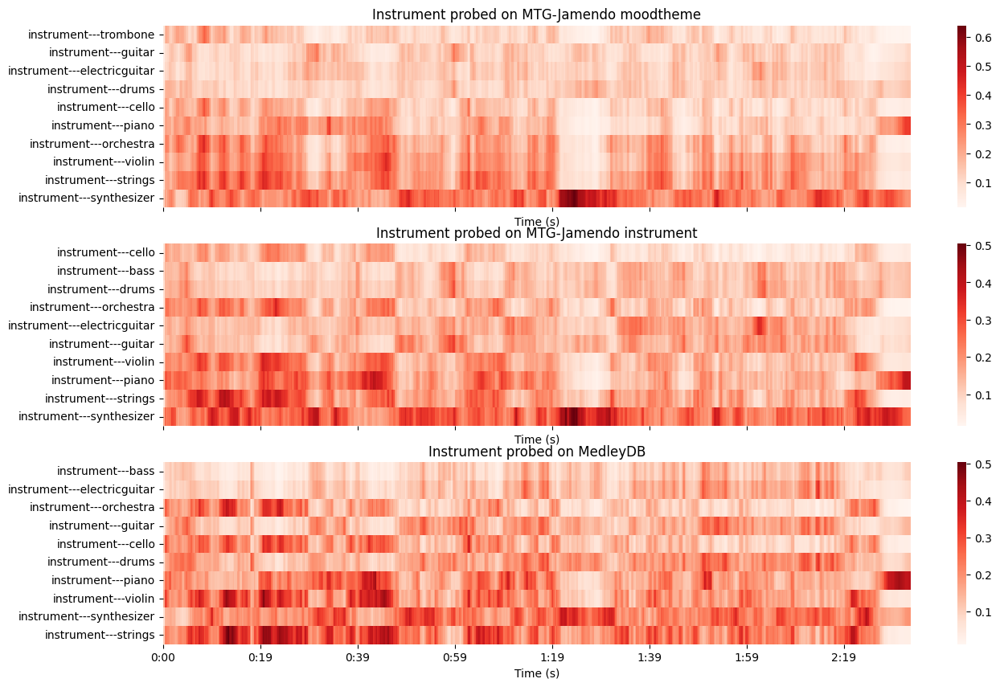

In [12]:
## cross domain plotting for each task on the same audio
## for instruments
mtg_mood_activations, classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['instrument'], overlap=0.9)
mtg_instruments_activations, classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['instrument'], overlap=0.9)
medleydb_instruments_activations, classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['medleydb']['instrument'], overlap=0.9)

fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_taggram(mtg_mood_activations, classes, 'Instrument probed on MTG-Jamendo moodtheme', ax = axs[0], overlap = 0.9)
plot_taggram(mtg_instruments_activations, classes, 'Instrument probed on MTG-Jamendo instrument', ax = axs[1], overlap = 0.9)
plot_taggram(medleydb_instruments_activations, classes, 'Instrument probed on MedleyDB', ax = axs[2], overlap = 0.9)

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:07<00:00,  2.35it/s]


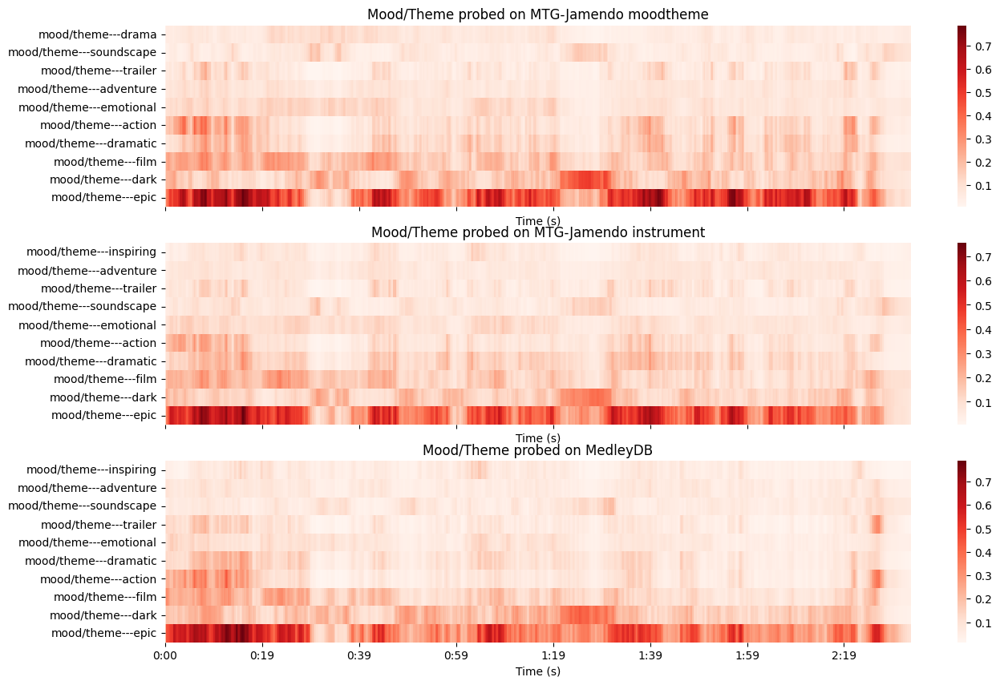

In [13]:
# moodtheme
mtg_mood_activations, classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['moodtheme'], overlap=0.9)
mtg_instruments_activations, classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['moodtheme'], overlap=0.9)
medleydb_instruments_activations, classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['medleydb']['moodtheme'], overlap=0.9)

fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_taggram(mtg_mood_activations, classes, 'Mood/Theme probed on MTG-Jamendo moodtheme', ax = axs[0], overlap = 0.9)
plot_taggram(mtg_instruments_activations, classes, 'Mood/Theme probed on MTG-Jamendo instrument', ax = axs[1], overlap = 0.9)
plot_taggram(medleydb_instruments_activations, classes, 'Mood/Theme probed on MedleyDB', ax = axs[2], overlap = 0.9)

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:07<00:00,  2.36it/s]


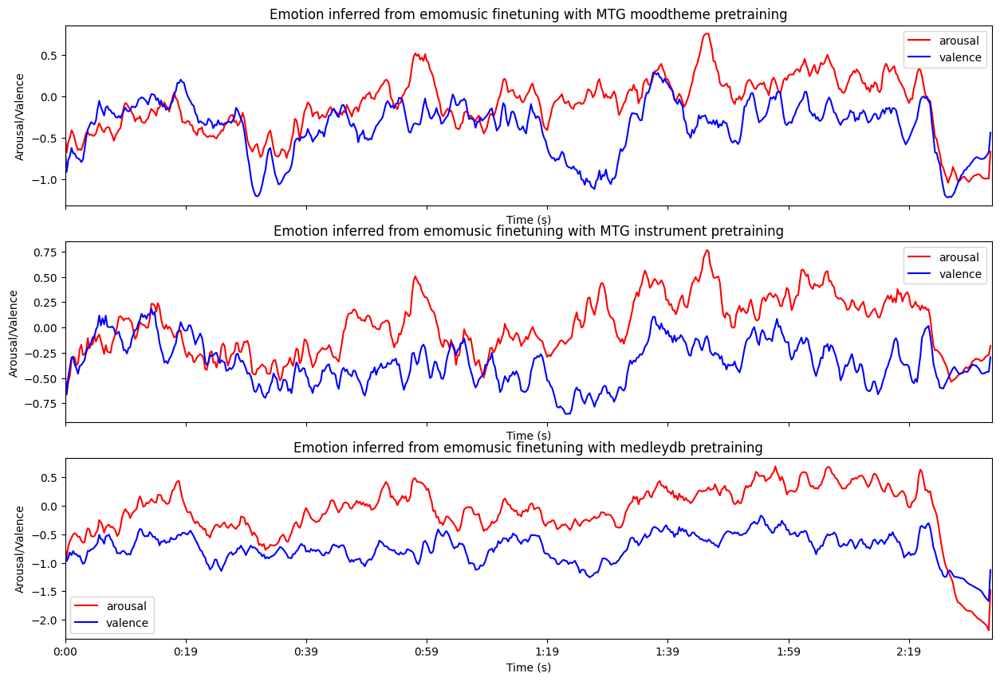

In [14]:
# emomusic
mtg_mood_activations, classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['emomusic'], overlap=0.9)
mtg_instruments_activations, classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['emomusic'], overlap=0.9)
medleydb_instruments_activations, classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['medleydb']['emomusic'], overlap=0.9)

fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_AV_activations(mtg_mood_activations, classes, 'Emotion inferred from emomusic finetuning with MTG moodtheme pretraining', ax = axs[0], overlap = 0.9)
plot_AV_activations(mtg_instruments_activations, classes, 'Emotion inferred from emomusic finetuning with MTG instrument pretraining', ax = axs[1], overlap = 0.9)
plot_AV_activations(medleydb_instruments_activations, classes, 'Emotion inferred from emomusic finetuning with medleydb pretraining', ax = axs[2], overlap = 0.9)

## 3. Case study 2 : Iris, by the goo goo dolls

To further explore our models, we leverage another track : Iris, by the goo goo dolls is rather instrumentally more simple, following a classic rock band rhythm section as well as a string section. However, the emotions of this track are more nuanced, with an array of different perceived emotions. We conduct the same exercise as the previous track to extract further qualitative insights about our models as well as confirm previously established observations.

### 3.1 : Loading and in-domain predictions.

We conduct the same initial in-domain extraction as for track 1 by loading the track, visualizing it, and extracting predictions by models probes on the same dataset they were pre-trained on.



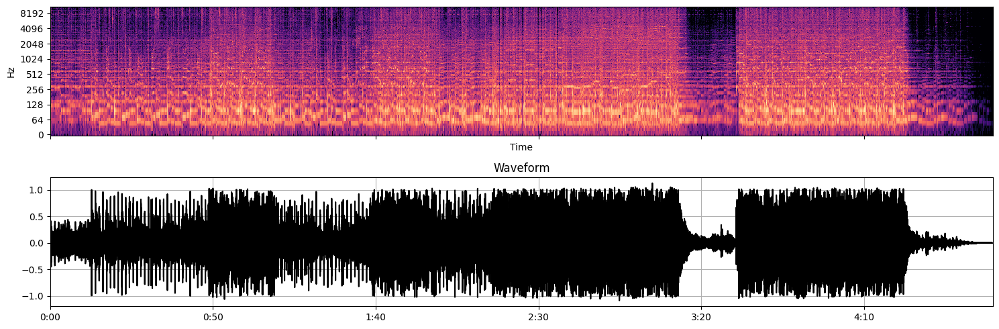

In [15]:
# example loading and predicting
from IPython.display import Audio
import numpy as np
DEFAULT_AUDIO_PATH = 'case_study_audio/Goo Goo Dolls - Iris.wav'

audio = load_full_audio(DEFAULT_AUDIO_PATH, DEFAULT_SR)
Audio(audio[0].numpy(), rate=DEFAULT_SR)


    
fig, axs = plt.subplots(2, 1, figsize=(15, 5), sharex=True)
plot_spectrogram_and_waveform(audio, DEFAULT_SR, axs)

Audio(audio[0].numpy(), rate=DEFAULT_SR)

In [16]:
moodtheme_activations, moodtheme_classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['moodtheme'], overlap = 0.9)
instrument_activations, instrument_classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['instrument'], overlap = 0.9)
emomusic_activations, emomusic_classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['emomusic'], overlap=0.9)


  9%|▉         | 3/34 [00:02<00:23,  1.31it/s]

100%|██████████| 34/34 [00:24<00:00,  1.40it/s]


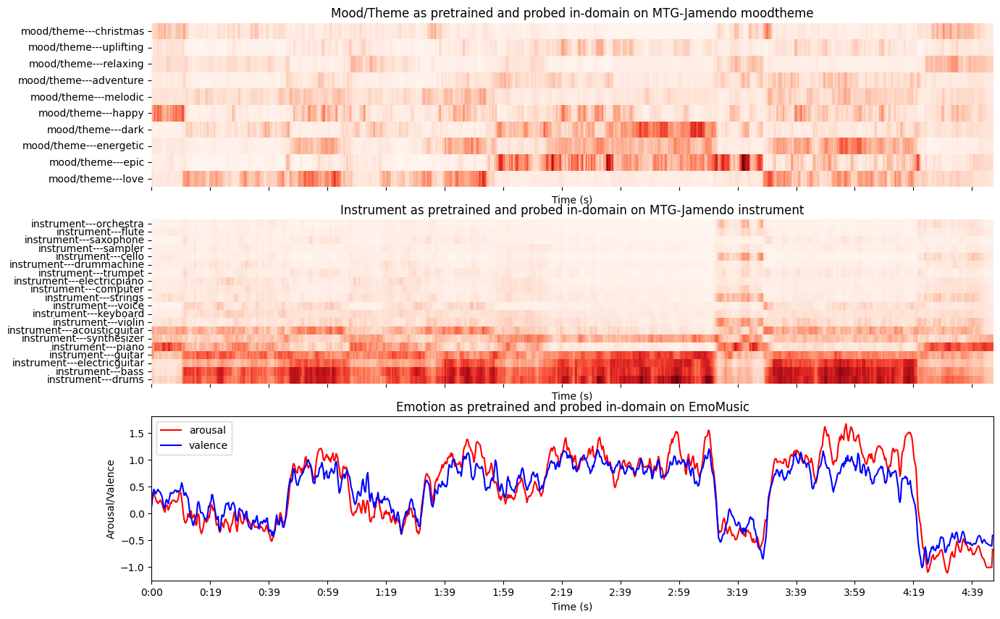

In [17]:
## all three on same subfigs
fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_taggram(moodtheme_activations, moodtheme_classes, 'Mood/Theme as pretrained and probed in-domain on MTG-Jamendo moodtheme', ax = axs[0], overlap = 0.9)
plot_taggram(instrument_activations, instrument_classes, 'Instrument as pretrained and probed in-domain on MTG-Jamendo instrument', ax = axs[1], topk = 20, overlap=0.9)
plot_AV_activations(emomusic_activations, emomusic_classes, 'Emotion as pretrained and probed in-domain on EmoMusic', ax = axs[2], overlap = 0.9)

# remove cbar from moodtheme and instrument
axs[0].collections[0].colorbar.remove()
axs[1].collections[0].colorbar.remove()

100%|██████████| 34/34 [00:24<00:00,  1.39it/s]


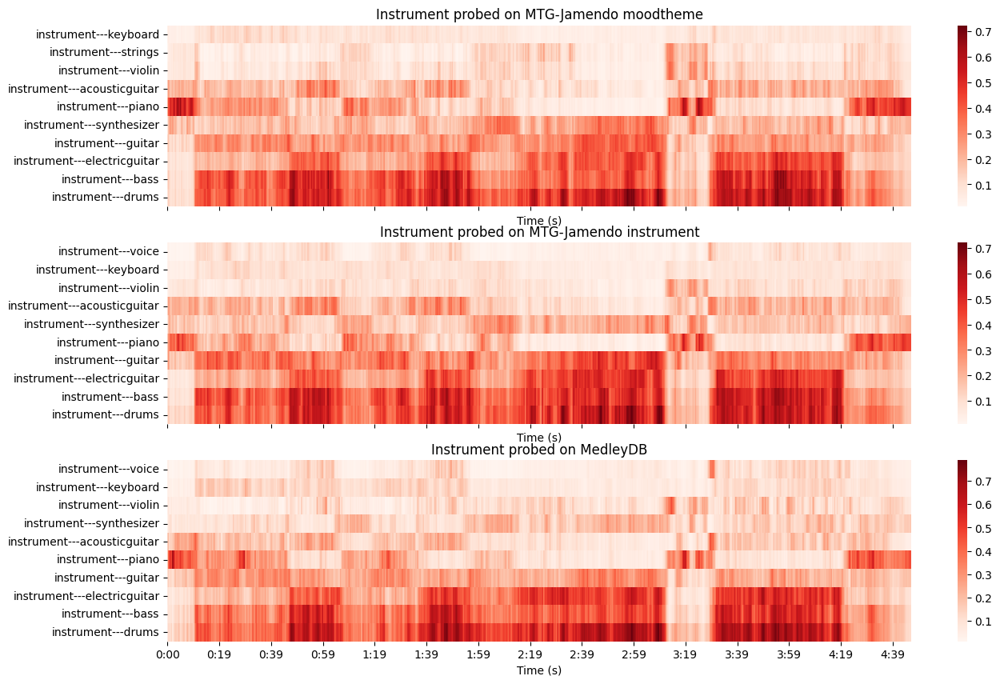

In [18]:
## cross domain plotting for each task on the same audio
## for instruments
mtg_mood_activations, classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['instrument'], overlap=0.9)
mtg_instruments_activations, classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['instrument'], overlap=0.9)
medleydb_instruments_activations, classes = get_activations_from_model(instrument_model, DEFAULT_AUDIO_PATH, checkpoints['medleydb']['instrument'], overlap=0.9)

fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_taggram(mtg_mood_activations, classes, 'Instrument probed on MTG-Jamendo moodtheme', ax = axs[0], overlap = 0.9)
plot_taggram(mtg_instruments_activations, classes, 'Instrument probed on MTG-Jamendo instrument', ax = axs[1], overlap = 0.9)
plot_taggram(medleydb_instruments_activations, classes, 'Instrument probed on MedleyDB', ax = axs[2], overlap = 0.9)

100%|██████████| 34/34 [00:24<00:00,  1.39it/s]


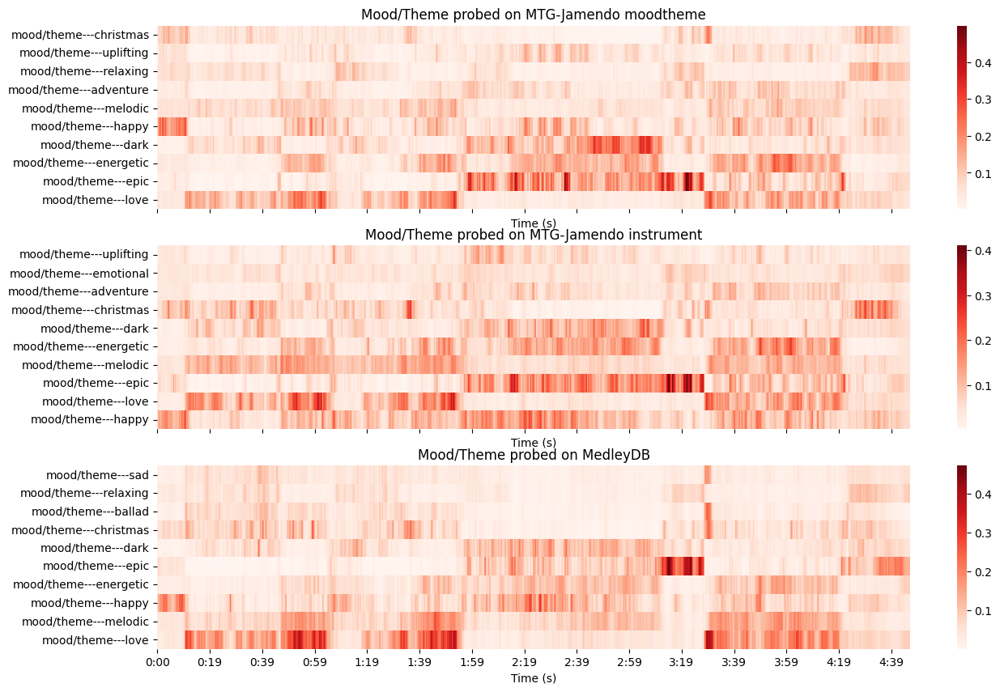

In [19]:
# moodtheme
mtg_mood_activations, classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['moodtheme'], overlap=0.9)
mtg_instruments_activations, classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['moodtheme'], overlap=0.9)
medleydb_instruments_activations, classes = get_activations_from_model(moodtheme_model, DEFAULT_AUDIO_PATH, checkpoints['medleydb']['moodtheme'], overlap=0.9)

fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_taggram(mtg_mood_activations, classes, 'Mood/Theme probed on MTG-Jamendo moodtheme', ax = axs[0], overlap = 0.9)
plot_taggram(mtg_instruments_activations, classes, 'Mood/Theme probed on MTG-Jamendo instrument', ax = axs[1], overlap = 0.9)
plot_taggram(medleydb_instruments_activations, classes, 'Mood/Theme probed on MedleyDB', ax = axs[2], overlap = 0.9)

100%|██████████| 34/34 [00:24<00:00,  1.40it/s]


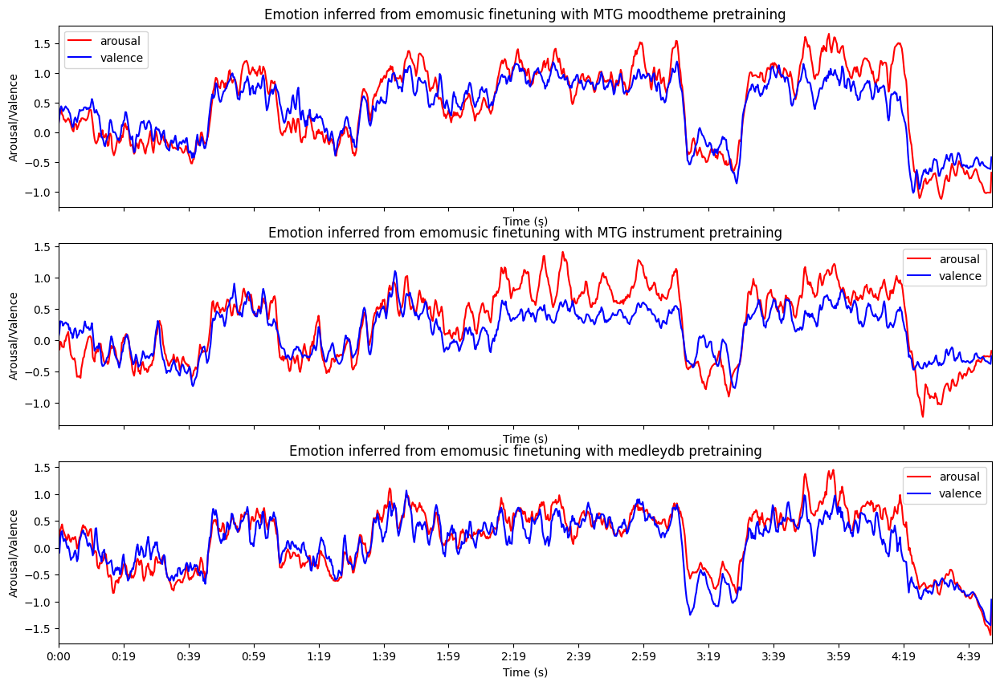

In [20]:
# emomusic
mtg_mood_activations, classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['moodtheme']['emomusic'], overlap=0.9)
mtg_instruments_activations, classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['instrument']['emomusic'], overlap=0.9)
medleydb_instruments_activations, classes = get_activations_from_model(emomusic_model, DEFAULT_AUDIO_PATH, checkpoints['medleydb']['emomusic'], overlap=0.9)

fig, axs = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
plot_AV_activations(mtg_mood_activations, classes, 'Emotion inferred from emomusic finetuning with MTG moodtheme pretraining', ax = axs[0], overlap = 0.9)
plot_AV_activations(mtg_instruments_activations, classes, 'Emotion inferred from emomusic finetuning with MTG instrument pretraining', ax = axs[1], overlap = 0.9)
plot_AV_activations(medleydb_instruments_activations, classes, 'Emotion inferred from emomusic finetuning with medleydb pretraining', ax = axs[2], overlap = 0.9)